# Task 4: Classification with Logistic Regression

Objective: Build a binary classifier using logistic regression.

Tools: Scikit-learn, Pandas, Matplotlib

## Importing the Dependencies

In [30]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

sns.set_style("whitegrid")

In [31]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("uciml/breast-cancer-wisconsin-data")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/breast-cancer-wisconsin-data


In [32]:
#Reading the dataset

df = pd.read_csv(path+"/data.csv")

In [33]:
#checking the first 5 rows of the dataset

df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [34]:
#data information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [35]:
#checking for the null values
df.isnull().sum()

,0
id,0
diagnosis,0
radius_mean,0
texture_mean,0
perimeter_mean,0
area_mean,0
smoothness_mean,0
compactness_mean,0
concavity_mean,0
concave points_mean,0


In [36]:
#checking for the duplicated values
df.duplicated().sum()

np.int64(0)

In [37]:
#removing the columns with null values
df.drop(['id','Unnamed: 32'],axis=1,inplace=True)

In [38]:
df['diagnosis'] = df['diagnosis'].map({'M':1,'B':0})

In [39]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   diagnosis                569 non-null    int64  
 1   radius_mean              569 non-null    float64
 2   texture_mean             569 non-null    float64
 3   perimeter_mean           569 non-null    float64
 4   area_mean                569 non-null    float64
 5   smoothness_mean          569 non-null    float64
 6   compactness_mean         569 non-null    float64
 7   concavity_mean           569 non-null    float64
 8   concave points_mean      569 non-null    float64
 9   symmetry_mean            569 non-null    float64
 10  fractal_dimension_mean   569 non-null    float64
 11  radius_se                569 non-null    float64
 12  texture_se               569 non-null    float64
 13  perimeter_se             569 non-null    float64
 14  area_se                  5

In [26]:
#checking for the correlation among the features with scatter plot
plt.figure(figsize=(100,50))
sns.pairplot(df,hue='diagnosis')
plt.legend(title='diagnosis')

<Figure size 10000x5000 with 0 Axes>

Observation: The scatter plot shows the relationship between different features, with points colored according to the diagnosis (Malignant or Benign). We can observe that some features show distinct clusters for malignant and benign tumors, suggesting their importance in classification. For example, features like 'radius_mean', 'perimeter_mean', and 'area_mean' seem to have a good separation between the two diagnosis types.

Text(0.5, 1.0, 'Correlation Heatmap')

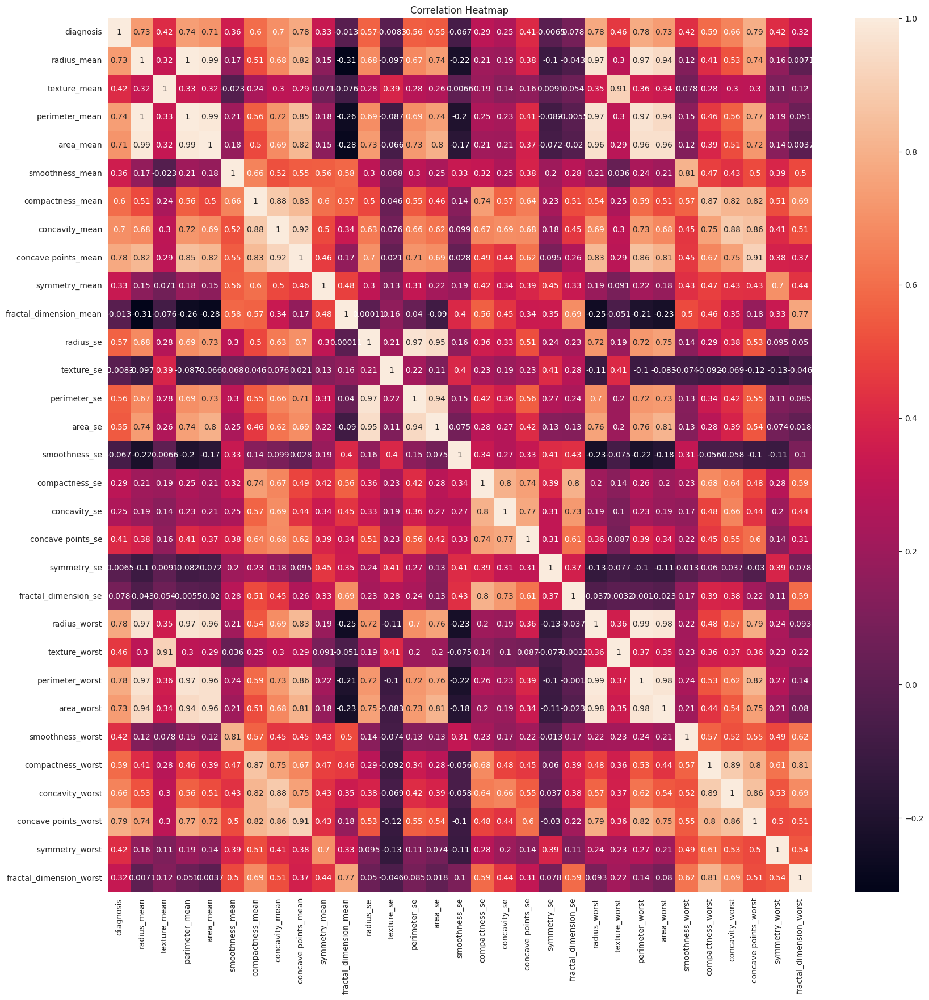

In [25]:
plt.figure(figsize=(20,20))
sns.heatmap(df.corr(),annot=True)
plt.title("Correlation Heatmap")


Observation: The heatmap shows a strong positive correlation between many of the features, particularly within the 'mean', 'se', and 'worst' groups of measurements. The 'diagnosis' variable shows varying degrees of correlation with the other features, indicating which features might be more important for classification.

## Train and Test split of the data

In [40]:

X = df.drop(['diagnosis'],axis=1)
y = df['diagnosis']

In [41]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X = scaler.fit_transform(X)

In [42]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

##Model Training

In [43]:
from sklearn.linear_model import LogisticRegression

model = LogisticRegression()
model.fit(X_train, y_train)

LogisticRegression()

In [44]:
#Predicting the values
pred = model.predict(X_test)

## Model Evaluation

              precision    recall  f1-score   support

           0       0.97      0.99      0.98        71
           1       0.98      0.95      0.96        43

    accuracy                           0.97       114
   macro avg       0.97      0.97      0.97       114
weighted avg       0.97      0.97      0.97       114

------------------------------------------------------------
Confusion matrix


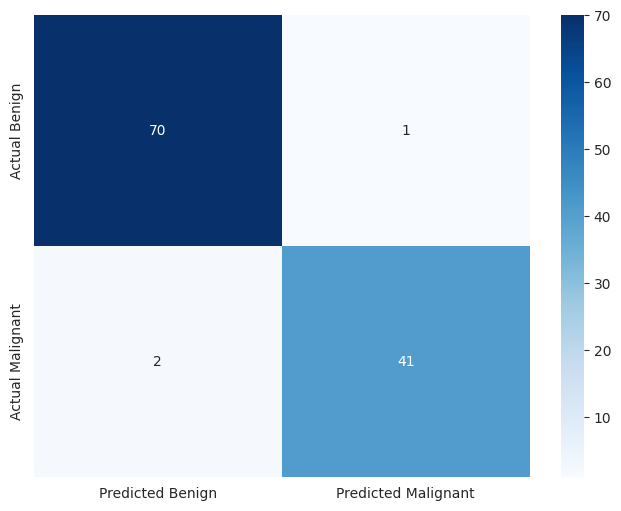

In [62]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

print(classification_report(y_test, pred))

fig, ax = plt.subplots(figsize=(8, 6))
print("--"*30)
print("Confusion matrix")
sns.heatmap(confusion_matrix(y_test,pred), annot=True, fmt='d', cmap='Blues',
            xticklabels=['Predicted Benign', 'Predicted Malignant'],
            yticklabels=['Actual Benign', 'Actual Malignant']) # Use the created axes
plt.show() # Display the plot

Observation:
* The model correctly predicted 70 instances as Benign when they were actually Benign (True Positives).
* The model correctly predicted 41 instances as Malignant when they were actually Malignant (True Negatives).
* The model incorrectly predicted 1 instance as Malignant when it was actually Benign (False Positive).
* The model incorrectly predicted 2 instances as Benign when they were actually Malignant (False Negatives).

In [59]:
print(f"The Accuracy of the Logistic Regression model is {accuracy_score(y_test,pred)*100:.2f} %")

The Accuracy of the Logistic Regression model is 97.37 %
